<a href="https://colab.research.google.com/github/pattrickx/signature_classification/blob/main/signature_classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import glob
from shutil import copyfile
import os
import pandas as pd
import cv2
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Importado Dados
[**DATA_BASE**](http://www.iapr-tc11.org/mediawiki/index.php/ICDAR_2011_Signature_Verification_Competition_(SigComp2011))

In [ ]:
!unzip "/content/drive/MyDrive/Ciência de dados/dados de assinatura.zip"

A saída de streaming foi truncada nas últimas 5000 linhas.
  inflating: dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Dutch/Reference(646)/053/18_053.PNG  
  inflating: dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Dutch/Reference(646)/053/19_053.PNG  
  inflating: dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Dutch/Reference(646)/053/21_053.PNG  
  inflating: dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Dutch/Reference(646)/053/22_053.PNG  
  inflating: dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Dutch/Reference(646)/053/23_053.PNG  
  inflating: dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Dutch/Reference(646)/053/24_053.PNG  
   creating: dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Dutch/Reference(646)/054/
  inflating: dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Dutch/Reference(646)/054/13_054.PNG  
  inflating: dado

# Data Cleaning and Structuring

In [ ]:
!mkdir data

In [ ]:
imgs = glob.glob("/content/dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Chinese/Questioned(487)/*/*.png")+glob.glob("/content/dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Chinese/Questioned(487)/*/*.PNG")
for img in imgs:
    nome = img.split("/")[-2][1:]
    n  = img.split("/")[-1].split("_")[0]
    n = n if n[0]!= "0" else n[1:]
    copyfile(img,f'/content/data/Chinese_{nome}_{n}_F.png')

In [ ]:
imgs = glob.glob("/content/dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Chinese/Ref(115)/*/*.png")+glob.glob("/content/dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Chinese/Ref(115)/*/*.PNG")
for img in imgs:
    nome = img.split("/")[-2][1:]
    n  = img.split("/")[-1].split("_")[0]
    n = n if n[0]!= "0" else n[1:]
    copyfile(img,f'/content/data/Chinese_{nome}_{n}_V.png')

In [ ]:
imgs = glob.glob("/content/dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Dutch/Questioned(1287)/*/*.PNG")+glob.glob("/content/dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Dutch/Questioned(1287)/*/*.png")
for img in imgs:
    nome = img.split("/")[-2][1:]
    n  = img.split("/")[-1].split("_")[0]
    n = n if n[0]!= "0" else n[1:]
    copyfile(img,f'/content/data/Dutch_{nome}_{n}_F.png')

In [ ]:
imgs = glob.glob("/content/dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Dutch/Reference(646)/*/*.PNG")+glob.glob("/content/dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Dutch/Reference(646)/*/*.png")
for img in imgs:
    nome = img.split("/")[-2][1:]
    n  = img.split("/")[-1].split("_")[0]
    n = n if n[0]!= "0" else n[1:]
    copyfile(img,f'/content/data/Dutch_{nome}_{n}_V.png')

# Extraindo informações

## Gerando CSV

In [ ]:
import base64
imgs = glob.glob('/content/data/*')
lista=[]
for img in imgs:
    name = os.path.basename(img)
    imagem = cv2.imread(img)
    
    # img_bin = cv2.imencode('.jpg', imagem)[1].tobytes()
    # base64_bytes = base64.b64encode(img_bin)
    # img_str = base64_bytes.decode('ascii')
    img_bin = cv2.imencode('.jpg', imagem)[1].tobytes()
    img_str = img_bin.hex()

    lista.append(name[:-4].split("_")+[img]+[imagem]+[img_str]+[imagem.shape[0]]+[imagem.shape[1]])

df = pd.DataFrame(columns=["lingua","nome","numero","autenticidade","path","imagem","str_imagem","w",'h'],data=lista)

In [ ]:
df.to_csv("assinaturas_img.csv",index=False)

#### Converter base 64

In [ ]:
import base64
img_bin = cv2.imencode('.jpg', df.imagem[0])[1].tobytes()
base64_bytes = base64.b64encode(img_bin)
img_str = base64_bytes.decode('ascii')
print(img_str)

/9j/4AAQSkZJRgABAQAAAQABAAD/2wBDAAIBAQEBAQIBAQECAgICAgQDAgICAgUEBAMEBgUGBgYFBgYGBwkIBgcJBwYGCAsICQoKCgoKBggLDAsKDAkKCgr/2wBDAQICAgICAgUDAwUKBwYHCgoKCgoKCgoKCgoKCgoKCgoKCgoKCgoKCgoKCgoKCgoKCgoKCgoKCgoKCgoKCgoKCgr/wAARCAEqAX4DASIAAhEBAxEB/8QAHwAAAQUBAQEBAQEAAAAAAAAAAAECAwQFBgcICQoL/8QAtRAAAgEDAwIEAwUFBAQAAAF9AQIDAAQRBRIhMUEGE1FhByJxFDKBkaEII0KxwRVS0fAkM2JyggkKFhcYGRolJicoKSo0NTY3ODk6Q0RFRkdISUpTVFVWV1hZWmNkZWZnaGlqc3R1dnd4eXqDhIWGh4iJipKTlJWWl5iZmqKjpKWmp6ipqrKztLW2t7i5usLDxMXGx8jJytLT1NXW19jZ2uHi4+Tl5ufo6erx8vP09fb3+Pn6/8QAHwEAAwEBAQEBAQEBAQAAAAAAAAECAwQFBgcICQoL/8QAtREAAgECBAQDBAcFBAQAAQJ3AAECAxEEBSExBhJBUQdhcRMiMoEIFEKRobHBCSMzUvAVYnLRChYkNOEl8RcYGRomJygpKjU2Nzg5OkNERUZHSElKU1RVVldYWVpjZGVmZ2hpanN0dXZ3eHl6goOEhYaHiImKkpOUlZaXmJmaoqOkpaanqKmqsrO0tba3uLm6wsPExcbHyMnK0tPU1dbX2Nna4uPk5ebn6Onq8vP09fb3+Pn6/9oADAMBAAIRAxEAPwD962dUwGOM9KODkGguo9801myAvl7gxwc1qecOKgtuGQemaRZFY7c0qkYAwBx0pGXceTx+tL1H0BWDjK56kcikRRGgC8/U0q9CGOeeOKA6njPIHcUCFHAxR8oHShd2Mtj8DRz3oAMjrn8aQBD1GfwpR8q/dAA6YoYAjB//AF0D

In [ ]:
base64_bytes = img_str.encode('ascii')
img_bin_res = base64.b64decode(base64_bytes)
img_1 = np.frombuffer(img_bin_res, np.uint8)
img = cv2.imdecode(img_1, flags=1)

In [ ]:

def str2img(str_img):
    base64_bytes = img_str.encode('ascii')
    img_bin_res = base64.b64decode(base64_bytes)
    img_1 = np.frombuffer(img_bin_res, np.uint8)
    return cv2.imdecode(img_1, flags=1)


#### Convert base 2


In [ ]:
img_bin = cv2.imencode('.jpg', df.imagem[0])[1].tobytes()
img_hex = img_bin.hex()


In [ ]:
def str2img(str_img):
    img_bin_res = bytes.fromhex(str_img)
    img_1 = np.frombuffer(img_bin_res, np.uint8)
    return cv2.imdecode(img_1, flags=1)

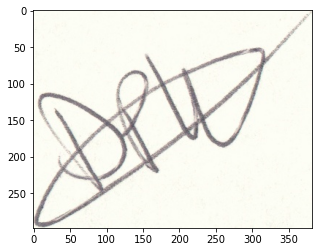

In [ ]:
plt.imshow(str2img(img_hex))
plt.show()

## Exibindo dados

In [ ]:
df.head(10)

,lingua,nome,numero,autenticidade,path,imagem,str_imagem,w,h
0,Dutch,55,19,V,/content/data/Dutch_55_19_V.png,"[[[252, 253, 242], [254, 253, 241], [253, 253,...",ffd8ffe000104a46494600010100000100010000ffdb00...,298,382
1,Dutch,52,9,F,/content/data/Dutch_52_9_F.png,"[[[253, 252, 238], [253, 253, 245], [253, 253,...",ffd8ffe000104a46494600010100000100010000ffdb00...,333,500
2,Dutch,66,17,V,/content/data/Dutch_66_17_V.png,"[[[253, 253, 245], [252, 253, 242], [252, 253,...",ffd8ffe000104a46494600010100000100010000ffdb00...,250,340
3,Chinese,16,13,V,/content/data/Chinese_16_13_V.png,"[[[255, 255, 255], [255, 255, 255], [251, 253,...",ffd8ffe000104a46494600010100000100010000ffdb00...,369,904
4,Dutch,52,13,V,/content/data/Dutch_52_13_V.png,"[[[240, 248, 237], [243, 249, 244], [250, 253,...",ffd8ffe000104a46494600010100000100010000ffdb00...,342,494
5,Dutch,30,14,V,/content/data/Dutch_30_14_V.png,"[[[254, 252, 243], [253, 253, 245], [254, 253,...",ffd8ffe000104a46494600010100000100010000ffdb00...,172,458
6,Dutch,42,18,V,/content/data/Dutch_42_18_V.png,"[[[253, 253, 245], [253, 253, 245], [253, 253,...",ffd8ffe000104a46494600010100000100010000ffdb00...,460,901
7,Chinese,15,3,F,/content/data/Chinese_15_3_F.png,"[[[0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], ...",ffd8ffe000104a46494600010100000100010000ffdb00...,363,920
8,Chinese,17,18,V,/content/data/Chinese_17_18_V.png,"[[[253, 254, 255], [247, 251, 253], [247, 253,...",ffd8ffe000104a46494600010100000100010000ffdb00...,381,934
9,Chinese,20,5,F,/content/data/Chinese_20_5_F.png,"[[[255, 255, 255], [255, 255, 255], [255, 255,...",ffd8ffe000104a46494600010100000100010000ffdb00...,551,1023


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1537 entries, 0 to 1536
Data columns (total 9 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   lingua         1537 non-null   object
 1   nome           1537 non-null   int64 
 2   numero         1537 non-null   int64 
 3   autenticidade  1537 non-null   object
 4   path           1537 non-null   object
 5   imagem         1537 non-null   object
 6   str_imagem     1537 non-null   object
 7   w              1537 non-null   int64 
 8   h              1537 non-null   int64 
dtypes: int64(4), object(5)
memory usage: 108.2+ KB


In [ ]:
df = pd.read_csv('assinaturas_img.csv')

# Exploração

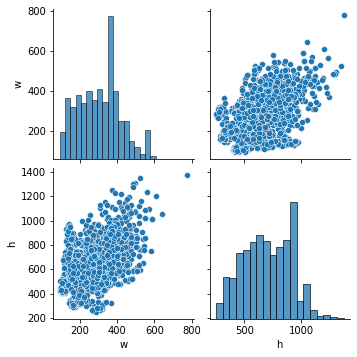

In [ ]:
sns.pairplot(df.drop("imagem",axis=1))

### Numero de imagens por lingua

In [ ]:
df_lingua_imagens = df.groupby('lingua').count().drop(["nome", "numero","autenticidade","path"],axis=1)
df_lingua_imagens.reset_index(inplace=True)
df_lingua_imagens

,lingua,imagem,str_imagem,w,h
0,Chinese,243,243,243,243
1,Dutch,1294,1294,1294,1294


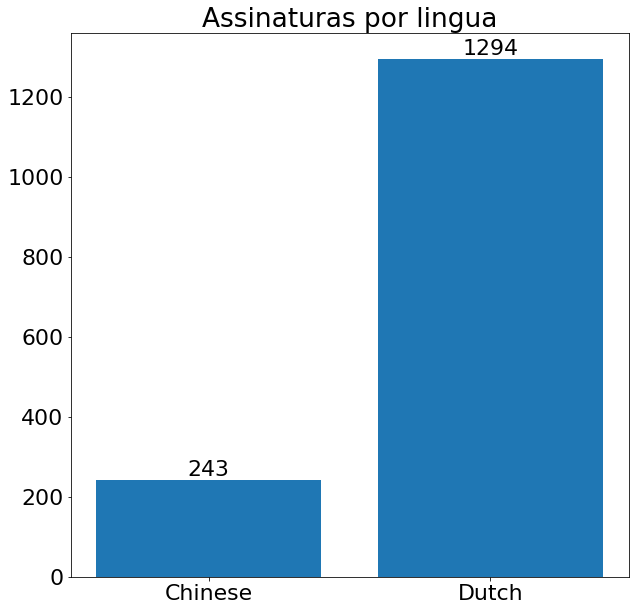

In [ ]:
plt.figure(figsize=(10,10))
colors = sns.color_palette('bright')[0:2]
#create pie chart
plt.rcParams.update({'font.size': 22})
plt.title('Assinaturas por lingua')
plt.bar(df_lingua_imagens['lingua'], df_lingua_imagens['imagem'] )
for i in range(len(df_lingua_imagens['imagem'])):
    plt.annotate(str(df_lingua_imagens['imagem'][i]), xy=(df_lingua_imagens['lingua'][i],df_lingua_imagens['imagem'][i]), ha='center', va='bottom')

plt.show()

### Numero de imagens verdadeiras e falsas por lingua

In [ ]:
df_lingua_autenticidade_imagens = df.groupby(['lingua','autenticidade']).count().drop(["nome", "numero","path"],axis=1)
df_lingua_autenticidade_imagens.reset_index(inplace=True)
df_lingua_autenticidade_imagens['lingua_autenticidade']=df_lingua_autenticidade_imagens['lingua']+"_"+df_lingua_autenticidade_imagens['autenticidade']
df_lingua_autenticidade_imagens

,lingua,autenticidade,imagem,str_imagem,w,h,lingua_autenticidade
0,Chinese,F,129,129,129,129,Chinese_F
1,Chinese,V,114,114,114,114,Chinese_V
2,Dutch,F,648,648,648,648,Dutch_F
3,Dutch,V,646,646,646,646,Dutch_V


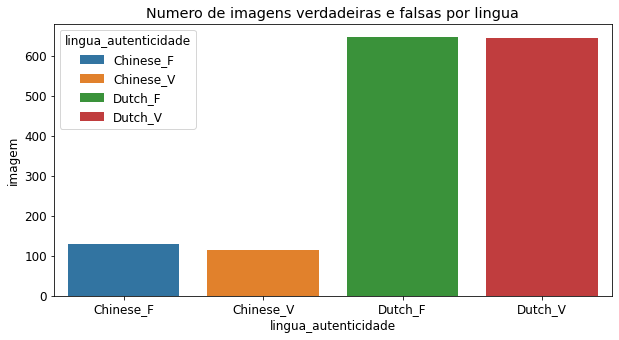

In [ ]:
plt.figure(figsize=(10,5))
plt.rcParams.update({'font.size': 12})
plt.title('Numero de imagens verdadeiras e falsas por lingua')
sns.barplot(x="lingua_autenticidade", y="imagem", hue="lingua_autenticidade",palette="tab10",dodge=False, data=df_lingua_autenticidade_imagens)
plt.show()

### Numero de individuos por lingua

In [ ]:
df_individuos_lingua = df.groupby(['lingua','nome']).count().groupby('lingua').count()
df_individuos_lingua.reset_index(inplace=True)
df_individuos_lingua

,lingua,numero,autenticidade,path,imagem,str_imagem,w,h
0,Chinese,10,10,10,10,10,10,10
1,Dutch,54,54,54,54,54,54,54


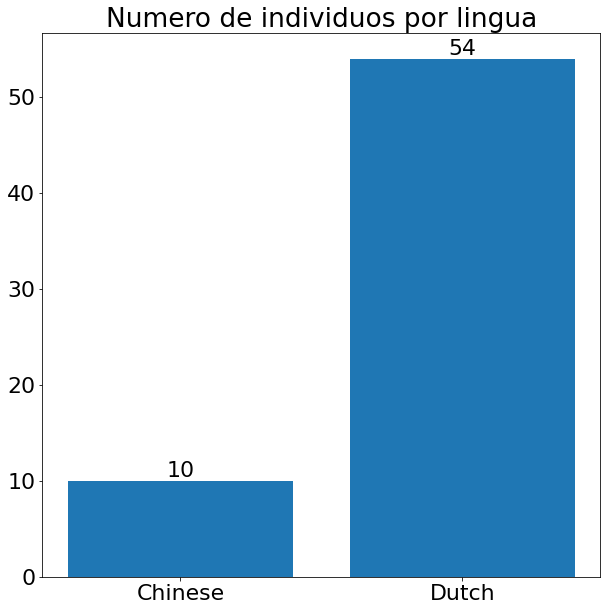

In [ ]:

plt.figure(figsize=(10,10))
colors = sns.color_palette('bright')[0:2]
#create pie chart
plt.rcParams.update({'font.size': 22})
plt.title('Numero de individuos por lingua')
plt.bar(df_individuos_lingua['lingua'], df_individuos_lingua['numero'] )
for i in range(len(df_individuos_lingua['numero'])):
    plt.annotate(str(df_individuos_lingua['numero'][i]), xy=(df_individuos_lingua['lingua'][i],df_individuos_lingua['numero'][i]), ha='center', va='bottom')

plt.show()

### Numero de imagem por individuo por lingua por autenticidade

In [ ]:
df_individuos_lingua_autenticidade = pd.DataFrame()
df_individuos_lingua_autenticidade["nome_autenticidade"] =df['nome']+"_"+df['autenticidade']


In [ ]:
df_individuos_lingua_autenticidade['nome_autenticidade'].describe()

count     1537
unique     118
top       19_F
freq        27
Name: nome_autenticidade, dtype: object

### Histograma de Largura

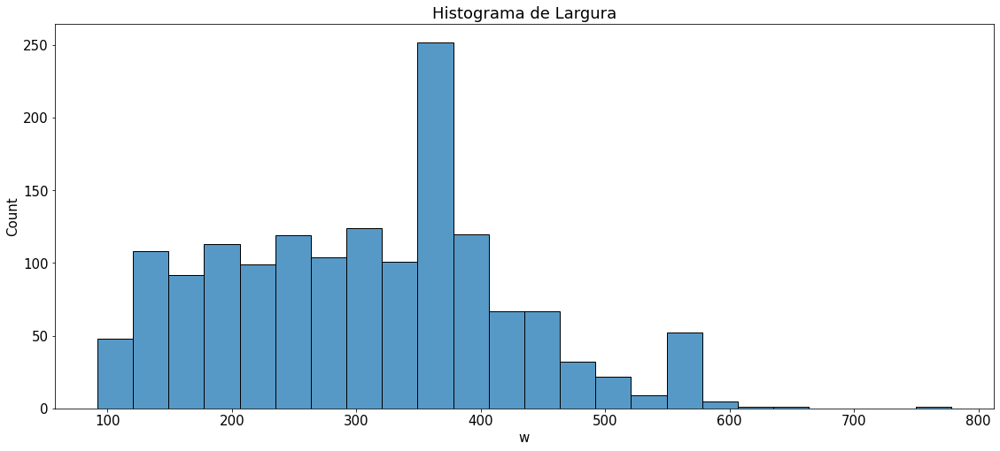

In [ ]:
plt.figure(figsize=(19,8))
plt.rcParams.update({'font.size': 15})
plt.title('Histograma de Largura')
# sns.barplot(x="nome", y="imagem", hue='lingua_autenticidade',palette="tab10" , data=df_individuos_lingua)
sns.histplot(data=df, x="w")
plt.show()

### Histograma de Altura

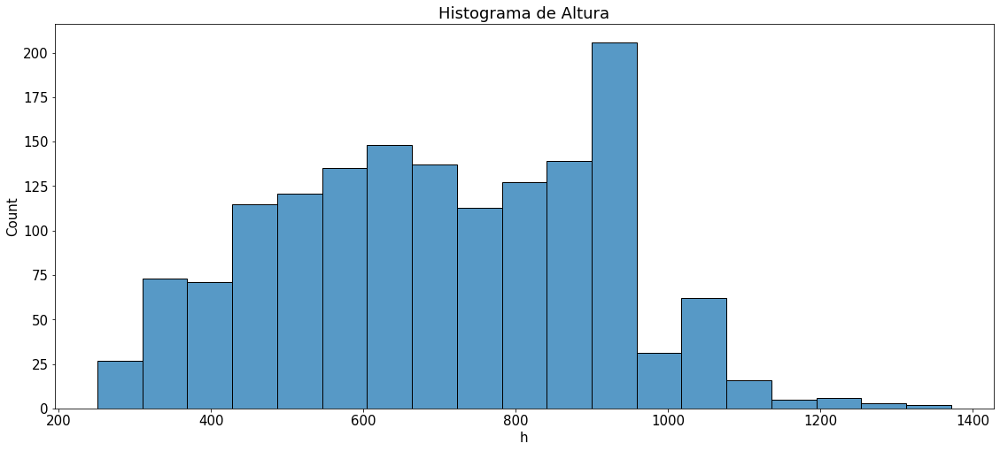

In [ ]:
plt.figure(figsize=(19,8))
plt.title('Histograma de Altura')
# sns.barplot(x="nome", y="imagem", hue='lingua_autenticidade',palette="tab10" , data=df_individuos_lingua)
sns.histplot(data=df, x="h")
plt.show()

### Histograma de cores

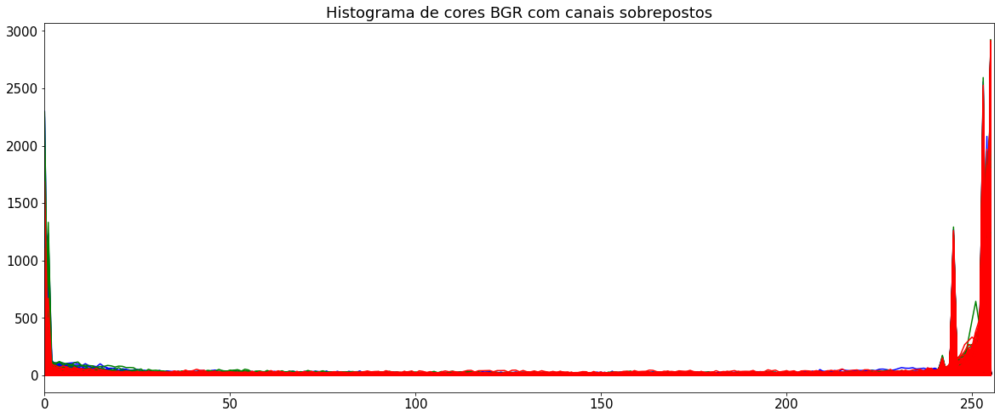

In [ ]:
plt.figure(figsize=(20,8))
plt.title('Histograma de cores BGR com canais sobrepostos')
# plt.subplot(1,3,1)
for img in df.imagem:
    hist_mask = cv2.calcHist(img, [0], None, [256], [0, 256])
    plt.plot(hist_mask, color='b')
    plt.xlim([0, 256])
# plt.subplot(1,3,2)
for img in df.imagem:
    hist_mask = cv2.calcHist(img, [1], None, [256], [0, 256])
    plt.plot(hist_mask, color='g')
    plt.xlim([0, 256])
# plt.subplot(1,3,3)
for img in df.imagem:
    hist_mask = cv2.calcHist(img, [2], None, [256], [0, 256])
    plt.plot(hist_mask, color='r')
    plt.xlim([0, 256])
plt.show()

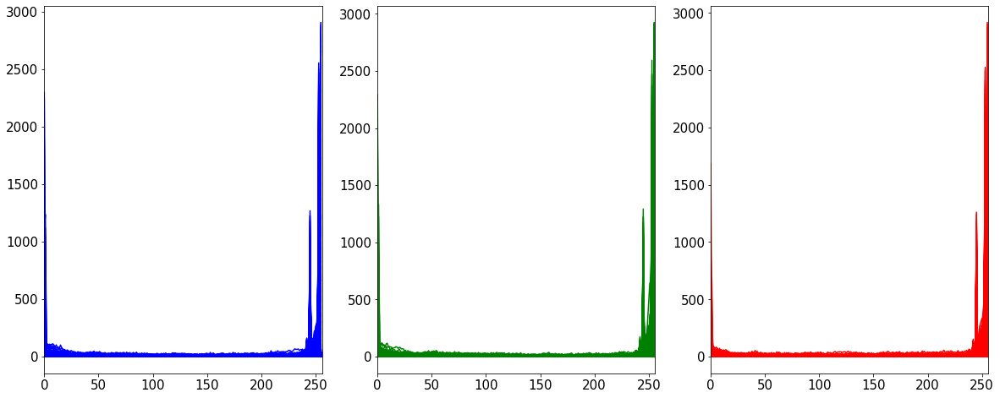

In [ ]:
plt.figure(figsize=(20,8))
plt.title('Histograma de cores BGR com canais separados')
plt.subplot(1,3,1)
for img in df.imagem:
    hist_mask = cv2.calcHist(img, [0], None, [256], [0, 256])
    plt.plot(hist_mask, color='b')
    plt.xlim([0, 256])
plt.subplot(1,3,2)
for img in df.imagem:
    hist_mask = cv2.calcHist(img, [1], None, [256], [0, 256])
    plt.plot(hist_mask, color='g')
    plt.xlim([0, 256])
plt.subplot(1,3,3)
for img in df.imagem:
    hist_mask = cv2.calcHist(img, [2], None, [256], [0, 256])
    plt.plot(hist_mask, color='r')
    plt.xlim([0, 256])
plt.show()


### Exibindo Classes

    lingua  nome  numero autenticidade    w    h
84   Dutch    66      20             V  248  538
96   Dutch    66      12             F  236  549
125  Dutch    66      17             V  250  340
297  Dutch    66      24             V  352  543
305  Dutch    66       8             F  261  449



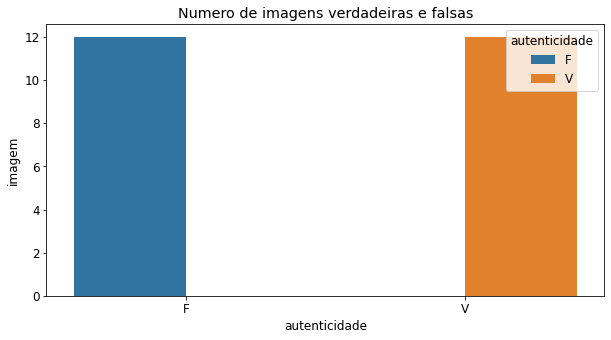

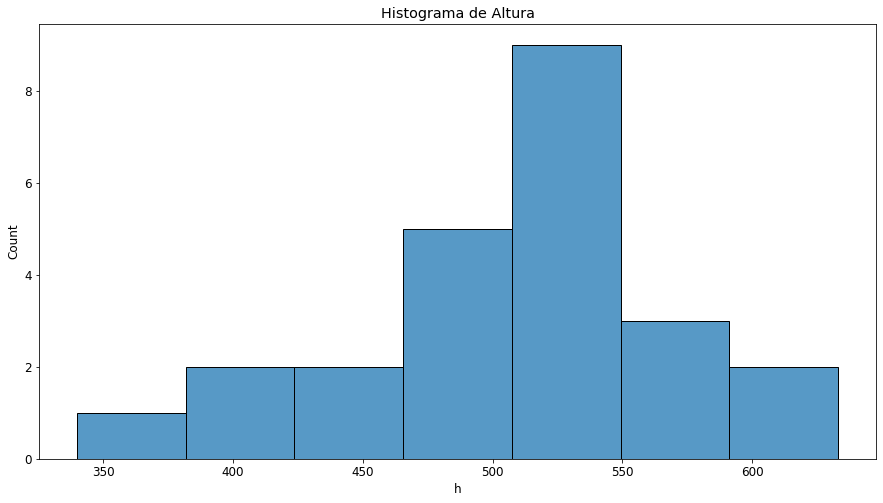

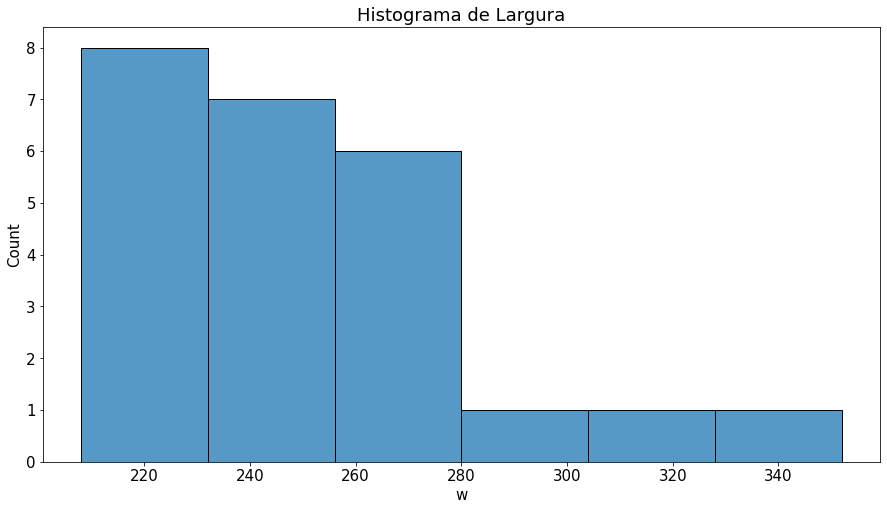

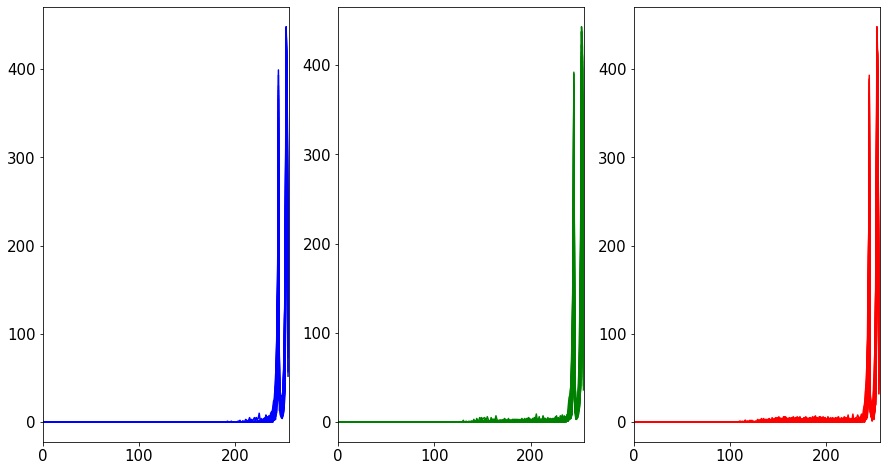

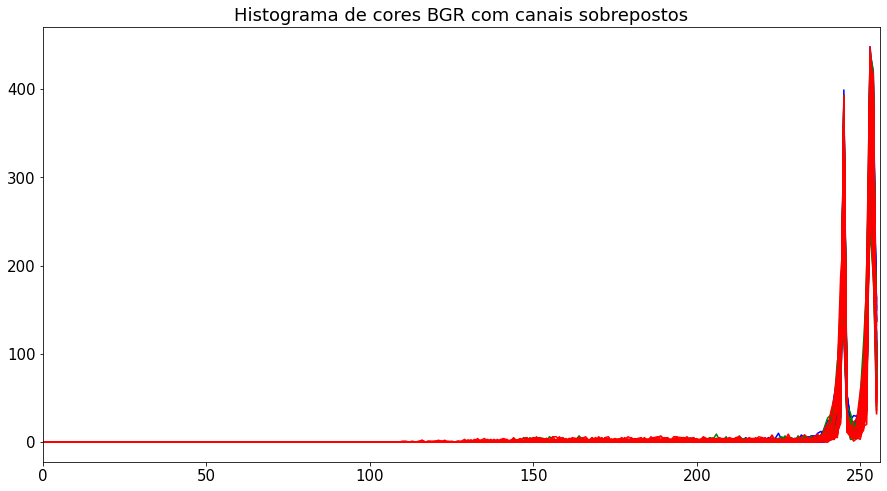


12 12
12



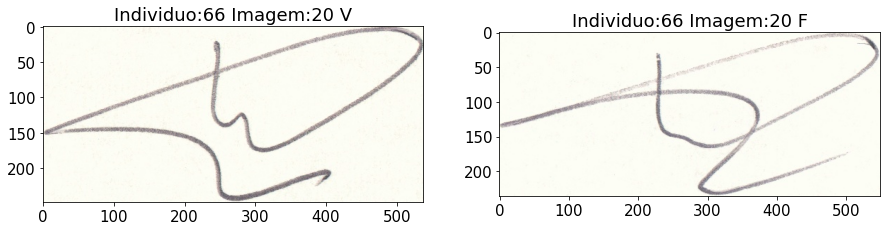

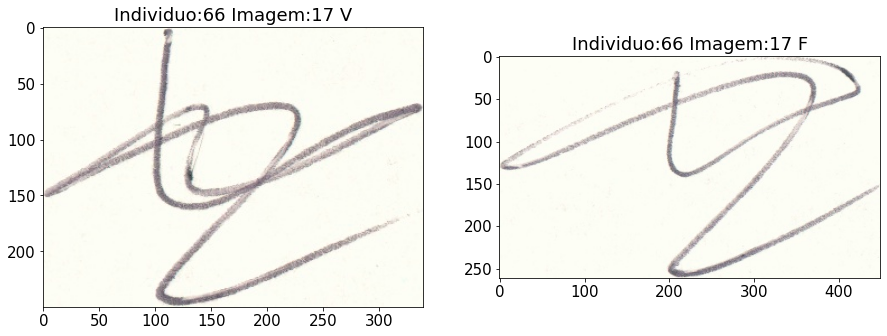

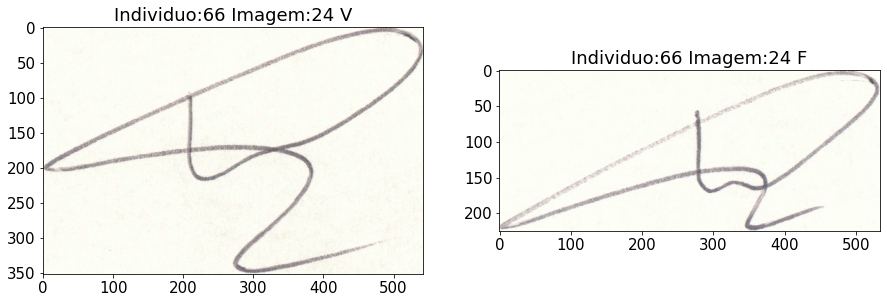

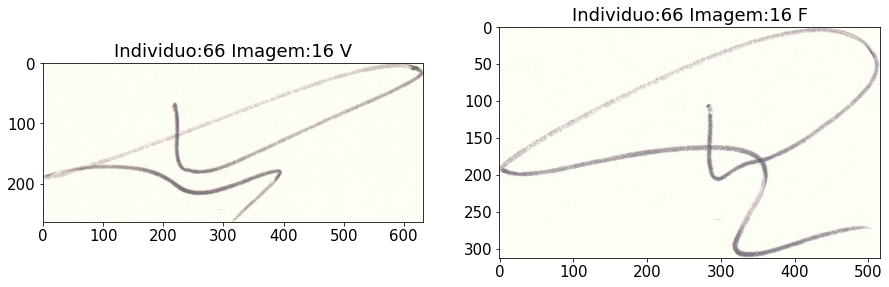

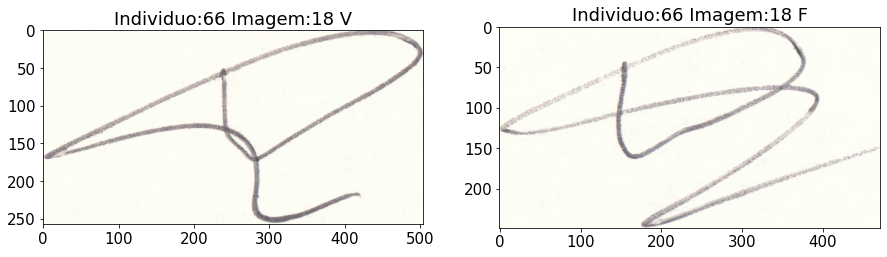

...

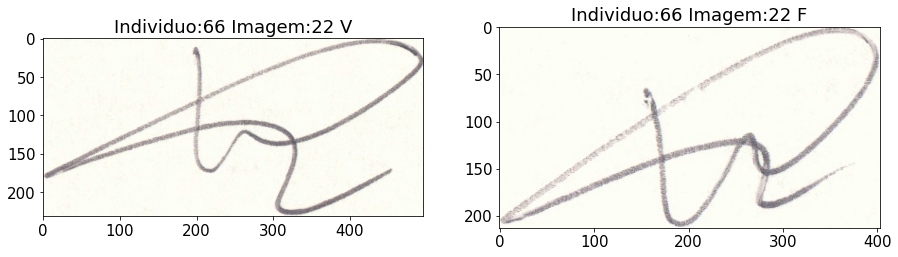

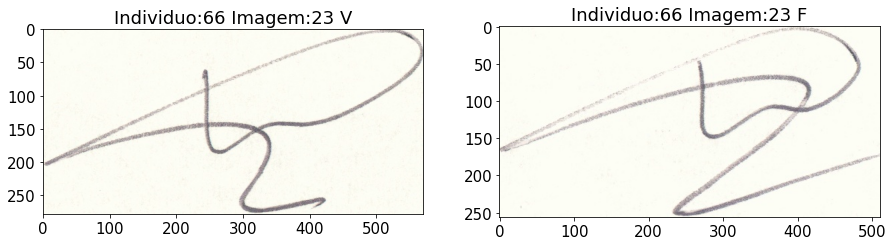

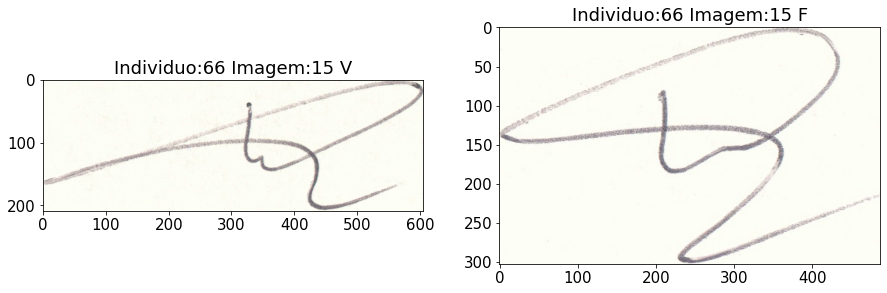

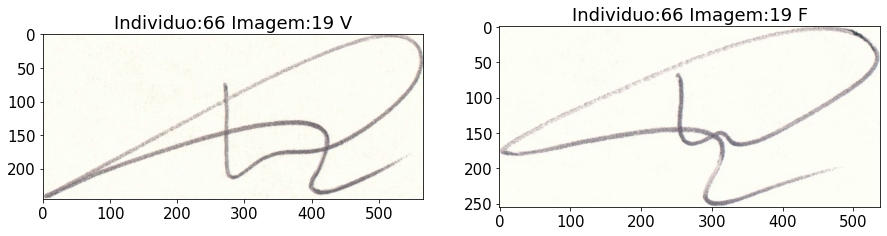

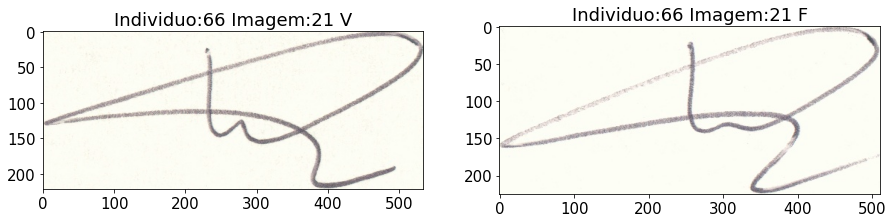

In [ ]:
#@title <b><font color="red" size="+3">←</font><font color="black" size="+3"> Aperte o Play</font></b>
#@markdown <h3>Escreve numero do individuo que seja ver</h3>
import math
df.nome = df.nome.astype('int64')
df.numero = df.numero.astype('int64')
#@markdown <h3>Escolha o numero do individuo que seja ver</h3>
individuo =  66#@param {type:"slider", min:11, max:69, step:1}

# individuo = str(individuo)
if not (df['nome']==individuo).any():
    print(f"Individuo {individuo} não existe")

else:
    df_individuo = df[df['nome']==individuo]


    print(df_individuo[["lingua","nome","numero","autenticidade","w",'h']].head())

    print("")  
    df_autenticidade_imagens = df_individuo.groupby("autenticidade").count()
    df_autenticidade_imagens.reset_index(inplace=True)
    plt.figure(figsize=(10,5))
    plt.rcParams.update({'font.size': 12})
    plt.title('Numero de imagens verdadeiras e falsas')
    sns.barplot(x="autenticidade", y="imagem", hue="autenticidade",
                palette="tab10", data=df_autenticidade_imagens)
    plt.show()
    print("")  

    plt.figure(figsize=(15,8))
    plt.title('Histograma de Altura')
    sns.histplot(data=df_individuo, x="h")
    plt.show()
    print("")  
    plt.figure(figsize=(15,8))
    plt.rcParams.update({'font.size': 15})
    plt.title('Histograma de Largura')
    # sns.barplot(x="nome", y="imagem", hue='lingua_autenticidade',palette="tab10" , data=df_individuos_lingua)
    sns.histplot(data=df_individuo, x="w")
    plt.show()
    print("")  
    plt.figure(figsize=(15,8))
    plt.title('Histograma de cores BGR com canais separados')
    plt.subplot(1,3,1)
    for img in df_individuo.str_imagem:
        hist_mask = cv2.calcHist(str2img(img), [0], None, [256], [0, 256])
        plt.plot(hist_mask, color='b')
        plt.xlim([0, 256])
    plt.subplot(1,3,2)
    for img in df_individuo.str_imagem:
        hist_mask = cv2.calcHist(str2img(img), [1], None, [256], [0, 256])
        plt.plot(hist_mask, color='g')
        plt.xlim([0, 256])
    plt.subplot(1,3,3)
    for img in df_individuo.str_imagem:
        hist_mask = cv2.calcHist(str2img(img), [2], None, [256], [0, 256])
        plt.plot(hist_mask, color='r')
        plt.xlim([0, 256])
    plt.show()

    # print("")  
    plt.figure(figsize=(15,8))
    plt.title('Histograma de cores BGR com canais sobrepostos')
    # plt.subplot(1,3,1)
    for img in df_individuo.str_imagem:
        hist_mask = cv2.calcHist(str2img(img), [0], None, [256], [0, 256])
        plt.plot(hist_mask, color='b')
        plt.xlim([0, 256])
    # plt.subplot(1,3,2)
    for img in df_individuo.str_imagem:
        hist_mask = cv2.calcHist(str2img(img), [1], None, [256], [0, 256])
        plt.plot(hist_mask, color='g')
        plt.xlim([0, 256])
    # plt.subplot(1,3,3)
    for img in df_individuo.str_imagem:
        hist_mask = cv2.calcHist(str2img(img), [2], None, [256], [0, 256])
        plt.plot(hist_mask, color='r')
        plt.xlim([0, 256])
    plt.show()
    print("")  
    df_individuo_v=df_individuo[df_individuo['autenticidade']=='V']
    df_individuo_v.reset_index(inplace=True)
    df_individuo_f=df_individuo[df_individuo['autenticidade']=='F']
    df_individuo_f.reset_index(inplace=True)
    print(len(df_individuo_v),len(df_individuo_f))
    Size = np.maximum(len(df_individuo_v),len(df_individuo_f))
    print(Size)
    for  i  in range(Size):   
        plt.figure(figsize=(15,8))

        plt.subplot(1,2,1)
        try:
            plt.imshow( str2img(df_individuo_v.str_imagem[i]))
            plt.title(f"Individuo:{individuo} Imagem:{df_individuo_v.numero[i]} V")
        except:
            aux=np.zeros((250,500,3), np.uint8)
            aux.fill(255)
            plt.imshow(aux)
        print("")   
        plt.subplot(1,2,2)
        try:
            plt.imshow( str2img(df_individuo_f.str_imagem[i]))
            plt.title(f"Individuo:{individuo} Imagem:{df_individuo_v.numero[i]} F")
        except:
            aux=np.zeros((250,500,3), np.uint8)
            aux.fill(255)
            plt.imshow(aux)
            
        plt.show()

In [ ]:
df.groupby(['nome','autenticidade']).count().sort_values('numero')

,,lingua,numero,path,imagem,str_imagem,w,h
nome,autenticidade,,,,,,,
53,V,11,11,11,11,11,11,11
29,V,11,11,11,11,11,11,11
11,F,12,12,12,12,12,12,12
53,F,12,12,12,12,12,12,12
52,V,12,12,12,12,12,12,12
...,...,...,...,...,...,...,...,...
18,V,24,24,24,24,24,24,24
20,F,25,25,25,25,25,25,25
13,F,26,26,26,26,26,26,26


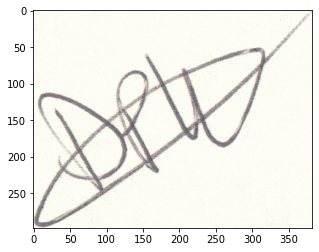

In [ ]:
plt.imshow(df["imagem"][0])

In [ ]:
df_chines = df.query('(lingua == "Chinese") & (nome == "11") ')

In [ ]:
df_chines.head()

,lingua,nome,numero,autenticidade,path,imagem,str_imagem,w,h
39,Chinese,11,3,F,/content/data/Chinese_11_3_F.png,"[[[254, 255, 255], [254, 254, 254], [254, 254,...",ffd8ffe000104a46494600010100000100010000ffdb00...,363,927
130,Chinese,11,20,V,/content/data/Chinese_11_20_V.png,"[[[254, 254, 254], [254, 254, 254], [254, 254,...",ffd8ffe000104a46494600010100000100010000ffdb00...,377,942
266,Chinese,11,13,V,/content/data/Chinese_11_13_V.png,"[[[254, 255, 255], [254, 254, 254], [254, 254,...",ffd8ffe000104a46494600010100000100010000ffdb00...,551,1023
278,Chinese,11,10,F,/content/data/Chinese_11_10_F.png,"[[[249, 250, 249], [251, 252, 250], [240, 242,...",ffd8ffe000104a46494600010100000100010000ffdb00...,365,941
280,Chinese,11,18,V,/content/data/Chinese_11_18_V.png,"[[[254, 255, 254], [255, 255, 255], [255, 255,...",ffd8ffe000104a46494600010100000100010000ffdb00...,379,939


In [ ]:
df_chines.groupby('autenticidade').count()

,lingua,nome,numero,path,imagem,str_imagem,w,h
autenticidade,,,,,,,,
F,12,12,12,12,12,12,12,12
V,12,12,12,12,12,12,12,12


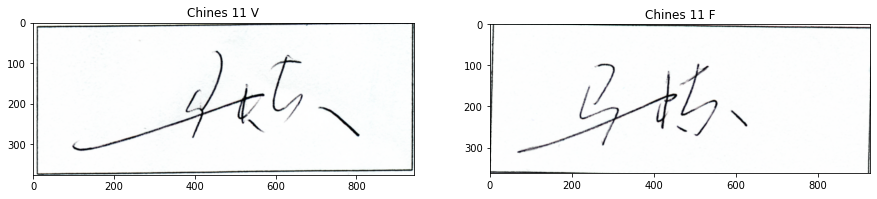

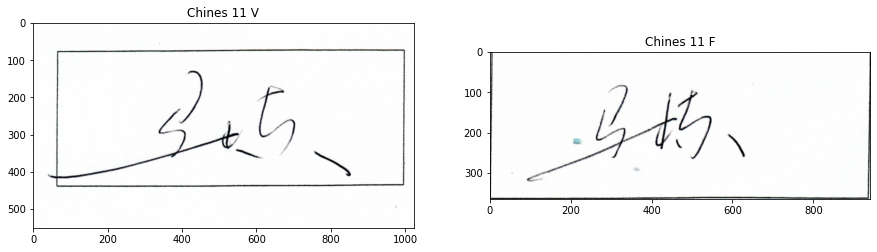

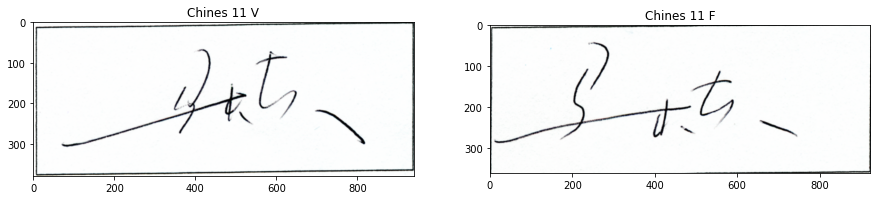

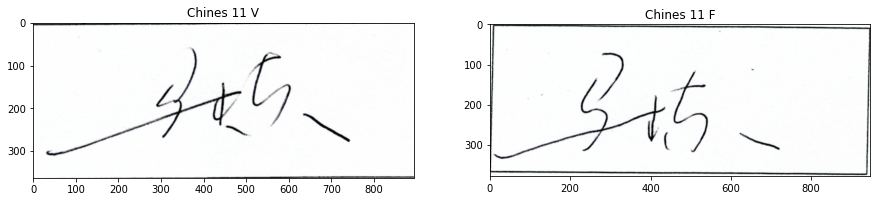

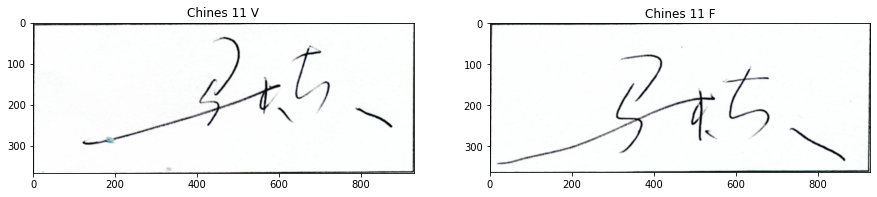

...

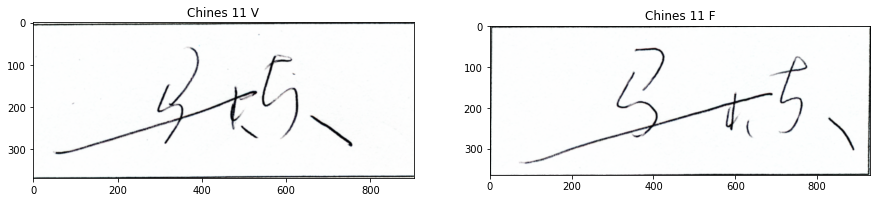

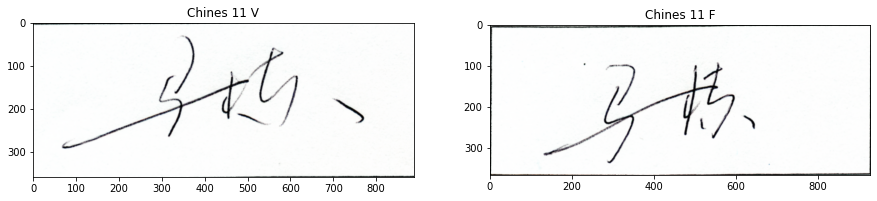

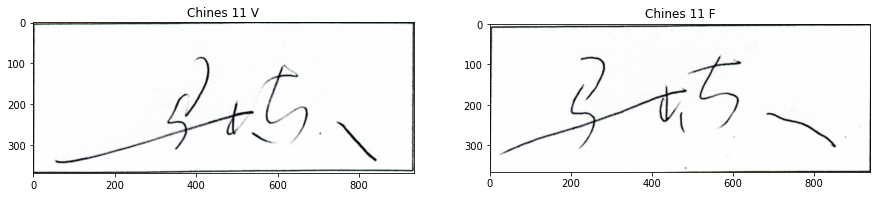

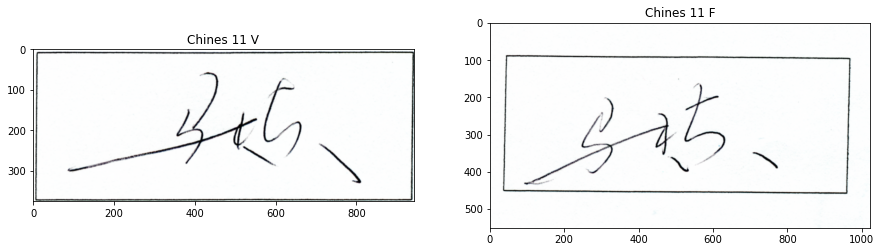

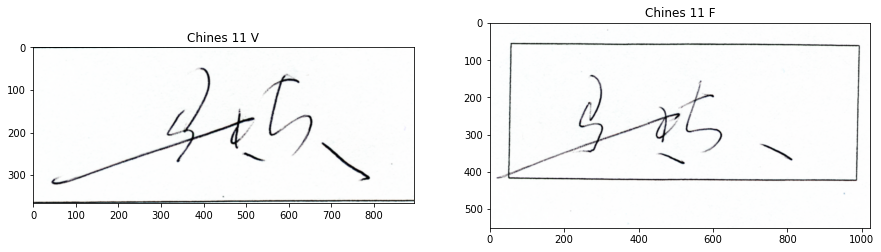

In [ ]:
for  i  in range(12):   
    plt.figure(figsize=(15,8))

    plt.subplot(1,2,1)
    plt.imshow(df_chines.query('(autenticidade=="V")').reset_index()['imagem'][i])
    plt.title("Chines 11 V")

    plt.subplot(1,2,2)
    plt.imshow(df_chines.query('(autenticidade=="F")').reset_index()['imagem'][i])
    plt.title("Chines 11 F")

    plt.show()

In [ ]:
df_chines = df.query('(lingua == "Chinese")')
df_chines_groupby_name= df_chines.groupby('nome')

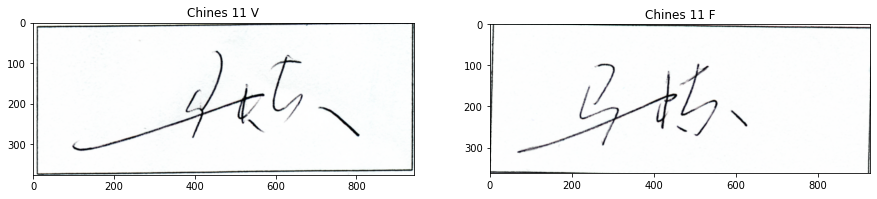

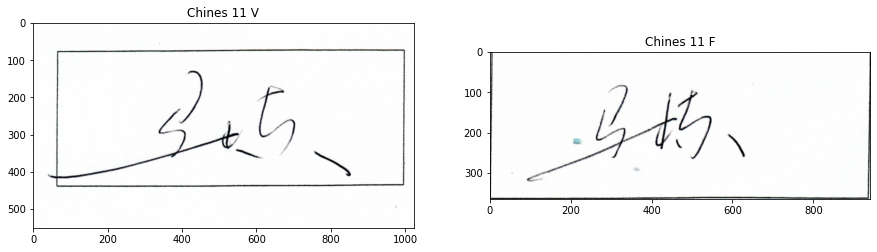

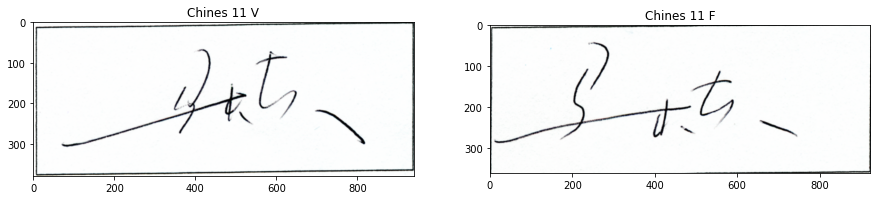

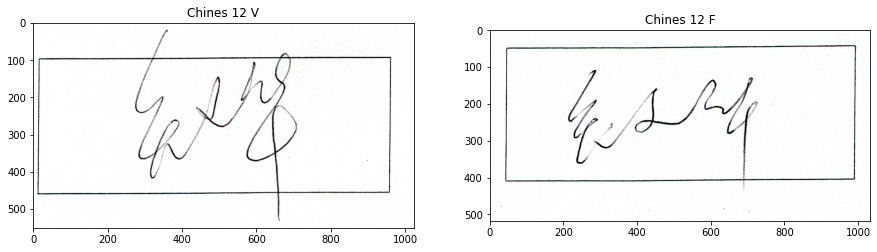

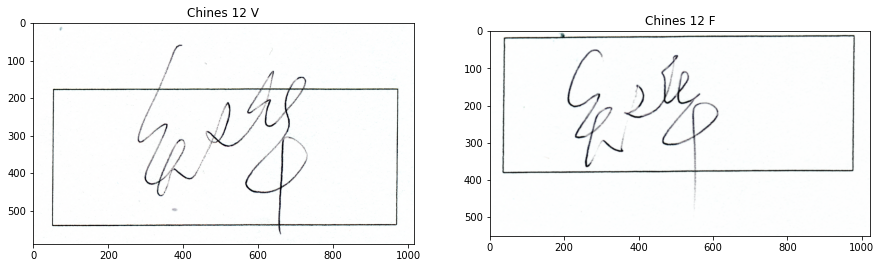

...

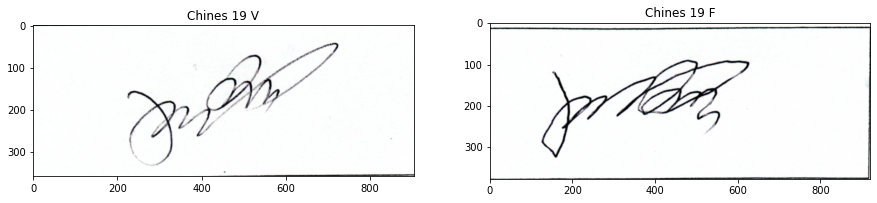

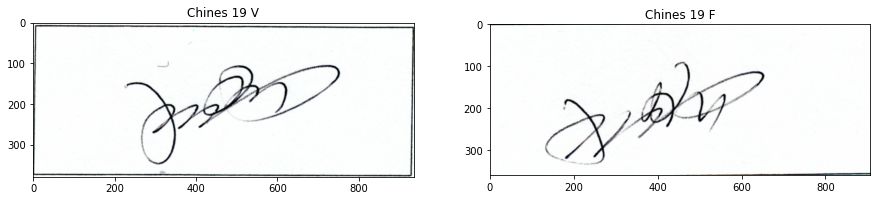

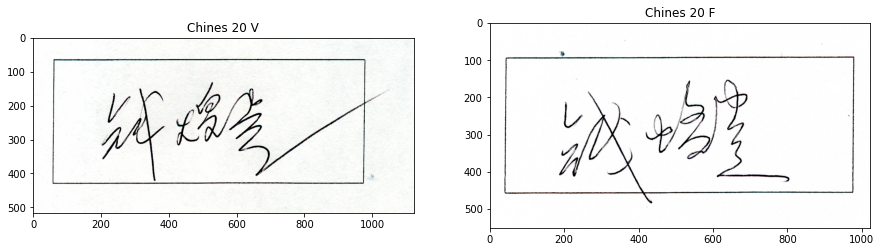

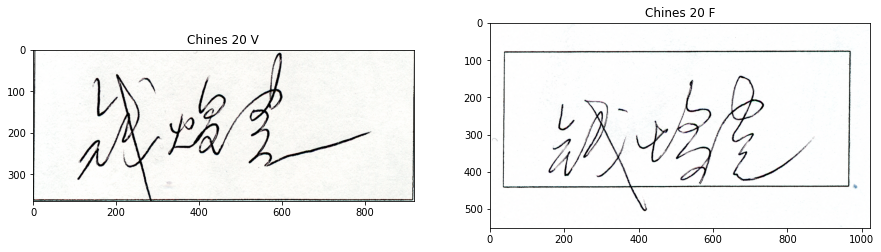

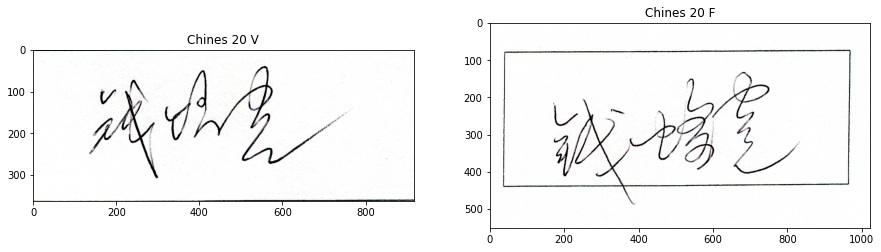

In [ ]:
for group_name, df_group in df_chines_groupby_name:

    for i in range(3):
        plt.figure(figsize=(15,8))

        plt.subplot(1,2,1)
        plt.imshow(df_group.query('(autenticidade=="V")').reset_index()['imagem'][i])
        plt.title(f"Chines {group_name} V")

        plt.subplot(1,2,2)
        plt.imshow(df_group.query('(autenticidade=="F")').reset_index()['imagem'][i])
        plt.title(f"Chines {group_name} F")

        plt.show()

## Holandês

In [ ]:
df_dutch = df.query('(lingua == "Dutch") & (nome == "62") ')
df_dutch.head()

,lingua,nome,numero,autenticidade,path,imagem,str_imagem,w,h
112,Dutch,62,19,V,/content/data/Dutch_62_19_V.png,"[[[253, 253, 245], [253, 253, 245], [253, 253,...",ffd8ffe000104a46494600010100000100010000ffdb00...,580,749
330,Dutch,62,8,F,/content/data/Dutch_62_8_F.png,"[[[253, 253, 245], [253, 253, 245], [253, 253,...",ffd8ffe000104a46494600010100000100010000ffdb00...,394,674
417,Dutch,62,3,F,/content/data/Dutch_62_3_F.png,"[[[253, 253, 245], [253, 253, 245], [253, 253,...",ffd8ffe000104a46494600010100000100010000ffdb00...,267,727
526,Dutch,62,21,V,/content/data/Dutch_62_21_V.png,"[[[253, 253, 245], [253, 253, 245], [252, 252,...",ffd8ffe000104a46494600010100000100010000ffdb00...,440,655
600,Dutch,62,9,F,/content/data/Dutch_62_9_F.png,"[[[253, 253, 245], [253, 253, 245], [253, 253,...",ffd8ffe000104a46494600010100000100010000ffdb00...,319,598


In [ ]:
df_dutch.groupby('autenticidade').count()

,lingua,nome,numero,path,imagem,str_imagem,w,h
autenticidade,,,,,,,,
F,12,12,12,12,12,12,12,12
V,12,12,12,12,12,12,12,12


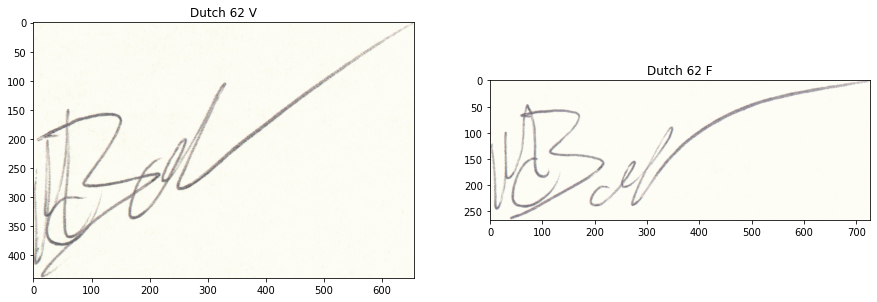

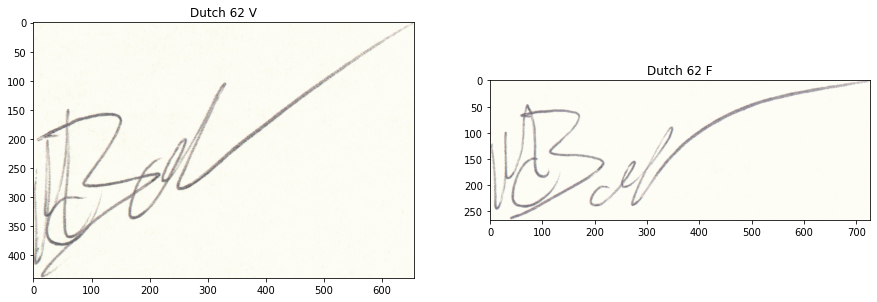

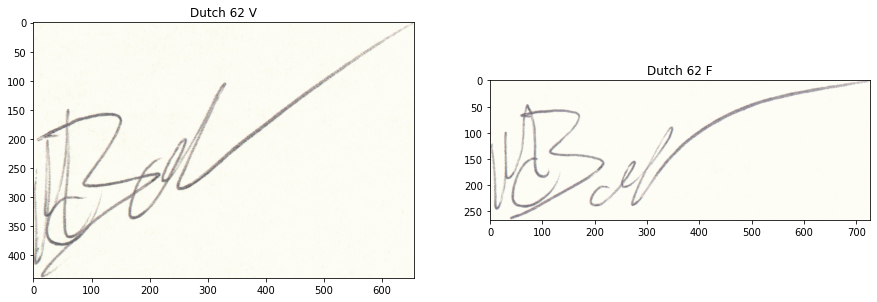

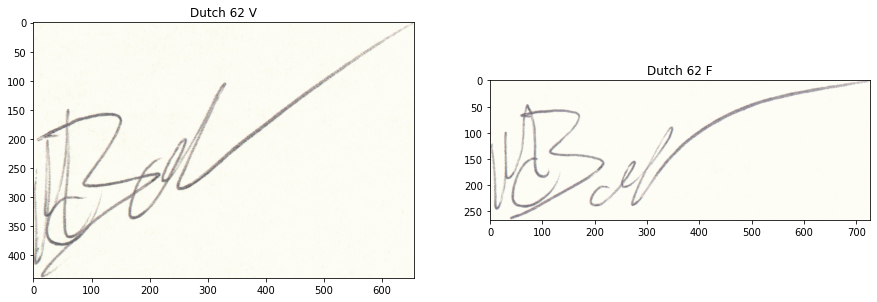

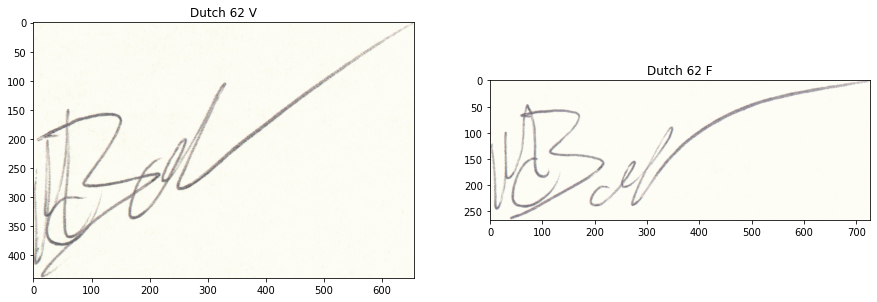

...

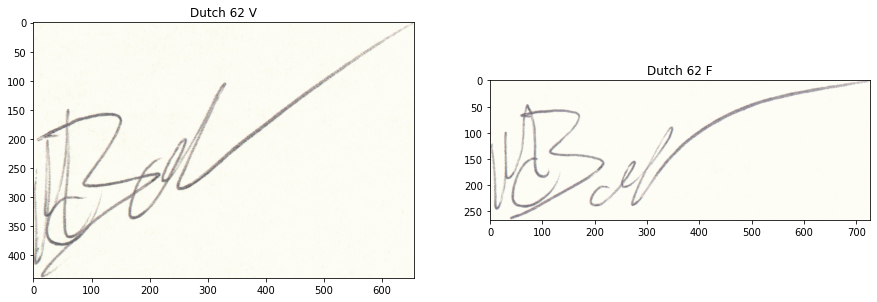

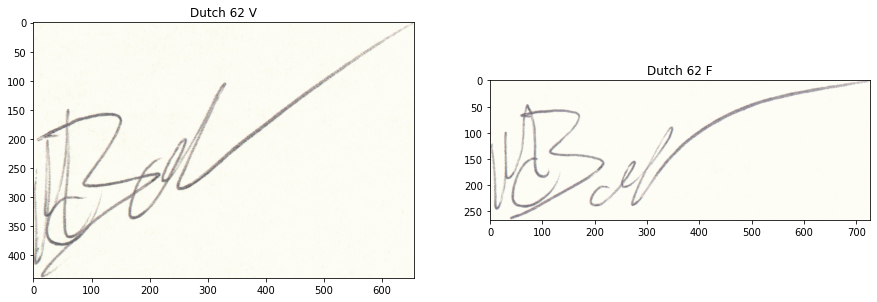

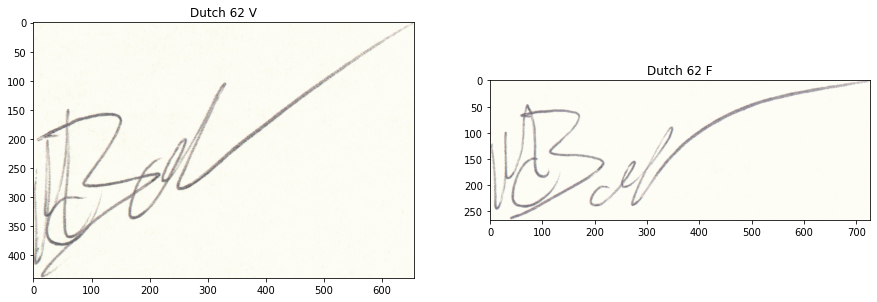

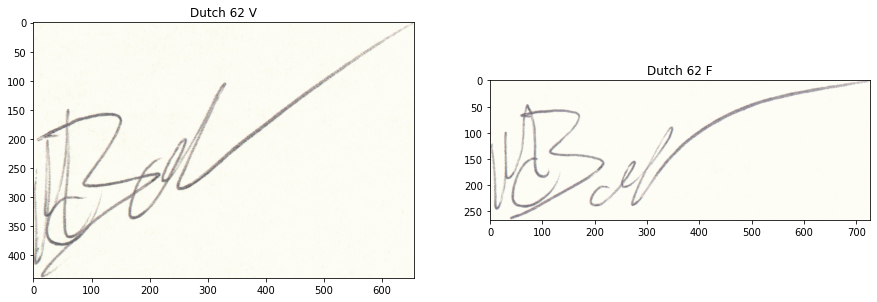

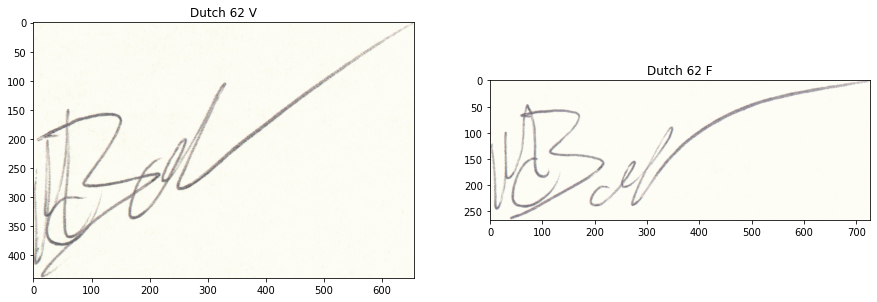

In [ ]:
for i in range(12):
    plt.figure(figsize=(15,8))

    plt.subplot(1,2,1)
    plt.imshow(df_dutch.query('(autenticidade=="V")').reset_index()['imagem'][1])
    plt.title("Dutch 62 V")

    plt.subplot(1,2,2)
    plt.imshow(df_dutch.query('(autenticidade=="F")').reset_index()['imagem'][1])
    plt.title("Dutch 62 F")

    plt.show()

In [ ]:
df_dutch = df.query('(lingua == "Dutch")')
df_dutch_groupby_name= df_dutch.groupby('nome')

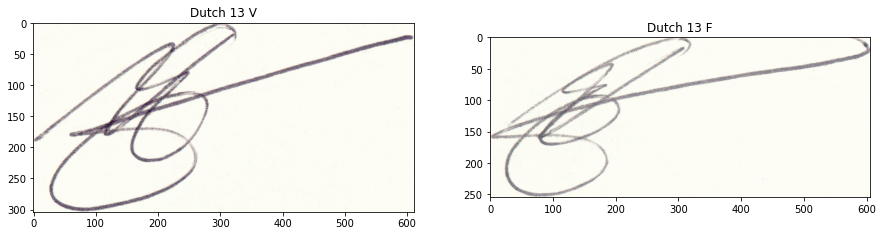

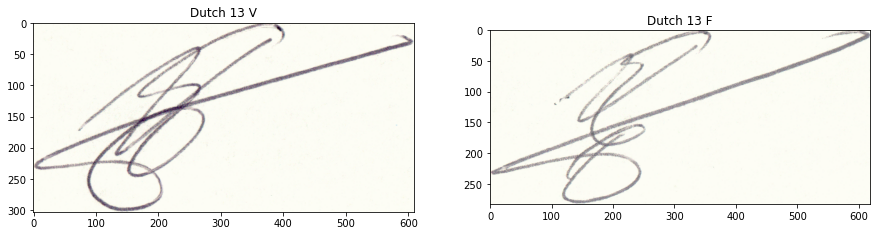

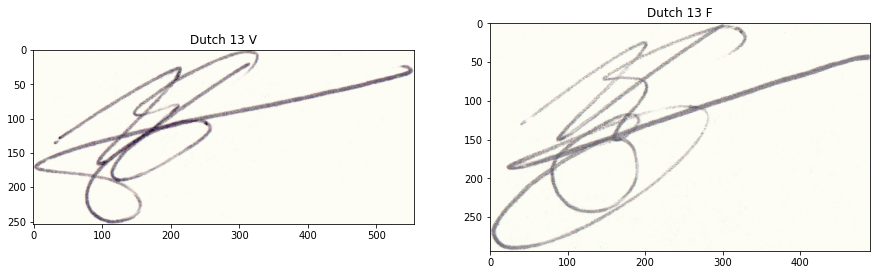

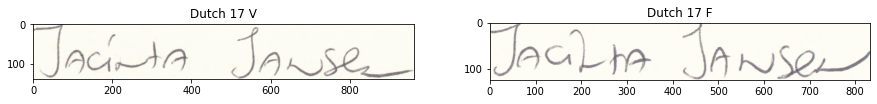

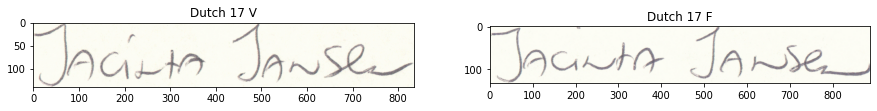

...

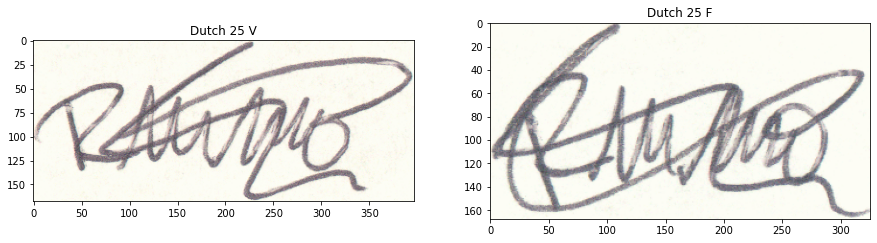

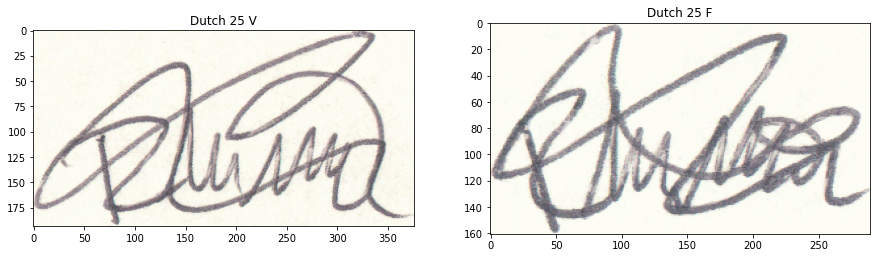

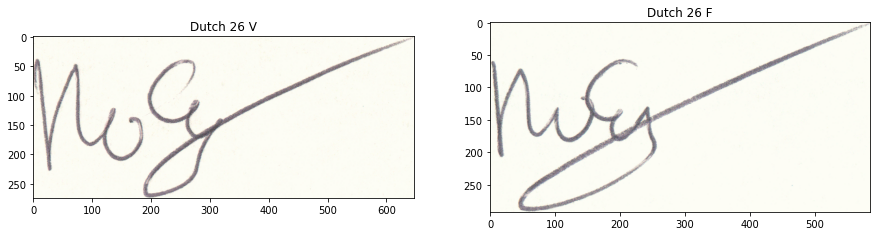

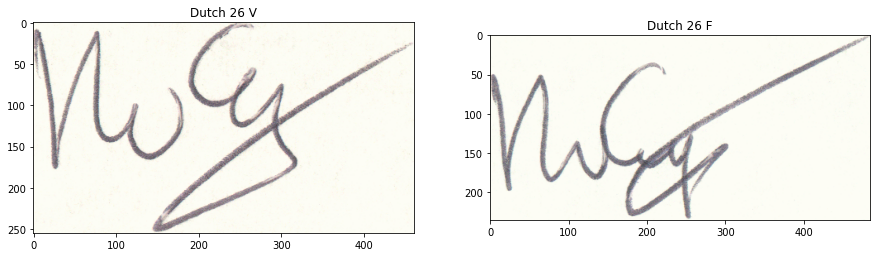

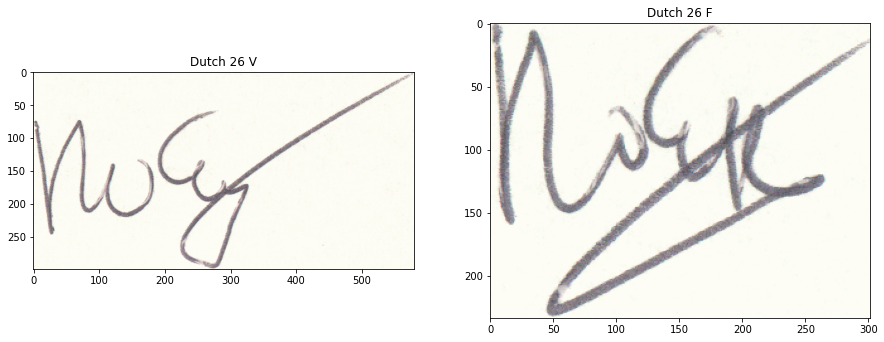

In [ ]:
for d,data in enumerate(df_dutch_groupby_name):
    group_name, df_group = data
    if d>10:
        break
    for i in range(3):
        plt.figure(figsize=(15,8))

        plt.subplot(1,2,1)
        plt.imshow(df_group.query('(autenticidade=="V")').reset_index()['imagem'][i])
        plt.title(f"Dutch {group_name} V")

        plt.subplot(1,2,2)
        plt.imshow(df_group.query('(autenticidade=="F")').reset_index()['imagem'][i])
        plt.title(f"Dutch {group_name} F")

        plt.show()

# Pre tratamento 


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### Criando pastas e organizando dados

In [3]:
!unzip "/content/drive/MyDrive/Ciência de dados/dados de assinatura.zip"

A saída de streaming foi truncada nas últimas 5000 linhas.
  inflating: dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Dutch/Reference(646)/053/18_053.PNG  
  inflating: dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Dutch/Reference(646)/053/19_053.PNG  
  inflating: dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Dutch/Reference(646)/053/21_053.PNG  
  inflating: dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Dutch/Reference(646)/053/22_053.PNG  
  inflating: dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Dutch/Reference(646)/053/23_053.PNG  
  inflating: dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Dutch/Reference(646)/053/24_053.PNG  
   creating: dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Dutch/Reference(646)/054/
  inflating: dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Dutch/Reference(646)/054/13_054.PNG  
  inflating: dado

In [4]:
!mkdir data

In [5]:
import glob
from shutil import copyfile
import os
imgs = glob.glob("/content/dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Chinese/Questioned(487)/*/*.png")+glob.glob("/content/dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Chinese/Questioned(487)/*/*.PNG")
for img in imgs:
    nome = img.split("/")[-2][1:]
    n  = img.split("/")[-1].split("_")[0]
    n = n if n[0]!= "0" else n[1:]
    copyfile(img,f'/content/data/Chinese_{nome}_{n}_F.png')

imgs = glob.glob("/content/dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Chinese/Ref(115)/*/*.png")+glob.glob("/content/dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Chinese/Ref(115)/*/*.PNG")
for img in imgs:
    nome = img.split("/")[-2][1:]
    n  = img.split("/")[-1].split("_")[0]
    n = n if n[0]!= "0" else n[1:]
    copyfile(img,f'/content/data/Chinese_{nome}_{n}_V.png')

imgs = glob.glob("/content/dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Dutch/Questioned(1287)/*/*.PNG")+glob.glob("/content/dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Dutch/Questioned(1287)/*/*.png")
for img in imgs:
    nome = img.split("/")[-2][1:]
    n  = img.split("/")[-1].split("_")[0]
    n = n if n[0]!= "0" else n[1:]
    copyfile(img,f'/content/data/Dutch_{nome}_{n}_F.png')

imgs = glob.glob("/content/dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Dutch/Reference(646)/*/*.PNG")+glob.glob("/content/dados de assinatura/Testdata_SigComp2011/SigComp11-Offlinetestset/Dutch/Reference(646)/*/*.png")
for img in imgs:
    nome = img.split("/")[-2][1:]
    n  = img.split("/")[-1].split("_")[0]
    n = n if n[0]!= "0" else n[1:]
    copyfile(img,f'/content/data/Dutch_{nome}_{n}_V.png')

### Imports

In [6]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

## lendo path das imagens e mostrando 1 exemplo



In [7]:
imgs_path = glob.glob('/content/data/*')
print(imgs_path[:2]) # print elementos
print(len(imgs_path)) # print tamanho

['/content/data/Dutch_22_8_F.png', '/content/data/Dutch_42_5_F.png']
1537


In [8]:
img_path = imgs_path[0]

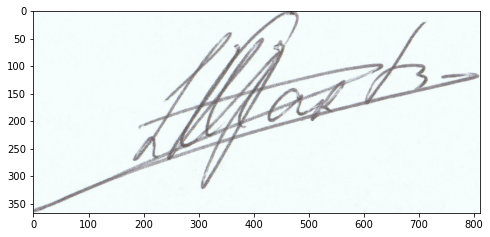

In [9]:
img_original =  cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB) 
plt.figure(figsize=(8,8))
plt.imshow(img_original)
plt.show()

### Gray scale


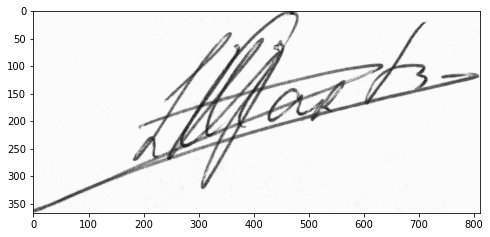

In [10]:
img_gray = cv2.cvtColor(img_original, cv2.COLOR_RGB2GRAY)
plt.figure(figsize=(8,8))
plt.imshow(img_gray, cmap='gray')
plt.show()

### Binarização

#### ADAPTIVE_THRESH_GAUSSIAN

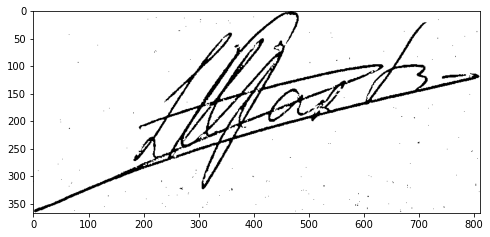

In [11]:
img_binary = cv2.adaptiveThreshold(img_gray,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,cv2.THRESH_BINARY,35,2)
kernel = np.ones((2,2))
img_binary = cv2.dilate(img_binary, kernel, iterations=1)

plt.figure(figsize=(8,8))
plt.imshow(img_binary, cmap='gray')
plt.show()

#### THRESH_BINARY

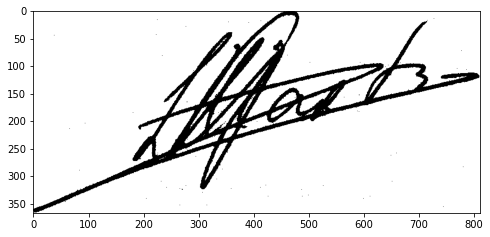

In [12]:
_, img_binary = cv2.threshold(img_gray, 240, 255, cv2.THRESH_BINARY)
plt.figure(figsize=(8,8))
plt.imshow(img_binary, cmap='gray')
plt.show()

#### THRESH_OTSU

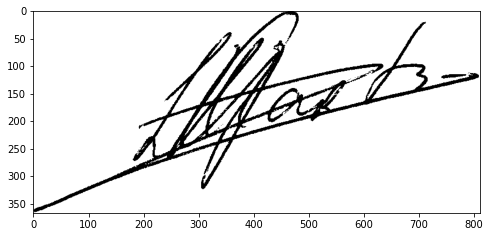

In [13]:
thresh = cv2.threshold(img_gray, 0, 255, cv2.THRESH_OTSU)[1]
plt.figure(figsize=(8,8))
plt.imshow(thresh, cmap='gray')
plt.show()

Inverse Binary

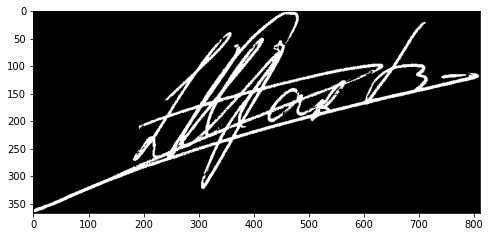

In [14]:
thresh = cv2.threshold(img_gray, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
plt.figure(figsize=(8,8))
plt.imshow(thresh, cmap='gray')
plt.show()

Esqueletização

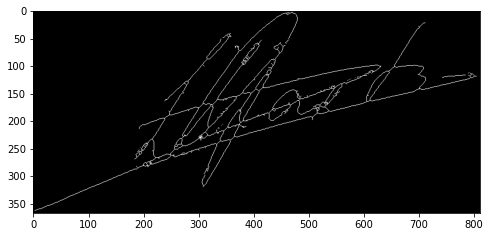

In [15]:
from skimage.morphology import thin

thinned = thin(thresh)

plt.figure(figsize=(8,8))
plt.imshow(thinned, cmap='gray')
plt.show()

HOG

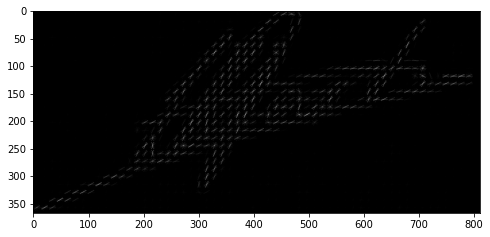

In [16]:
from skimage.feature import hog
from skimage.io import imread
from skimage.transform import rescale

img_hog, test_hog_img = hog(
    img_gray, pixels_per_cell=(14,14), 
    cells_per_block=(2, 2), 
    orientations=9, 
    visualize=True, 
    block_norm='L2-Hys')

plt.figure(figsize=(8,8))
plt.imshow(test_hog_img, cmap='gray')
plt.show()

In [17]:
len(img_hog) # tamanho do array hog

50400

## Criando dataset


In [18]:
import pandas as pd

In [19]:
imgs_path = glob.glob('/content/data/*')

In [20]:
lista = []
for img_path in imgs_path:
    
    img_gray = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2GRAY)
    
    dim = (450, 450)
    img_gray = cv2.resize(img_gray, dim, interpolation = cv2.INTER_AREA)

    img_hog,_= hog(
    img_gray, pixels_per_cell=(14,14), 
    cells_per_block=(2, 2), 
    orientations=9, 
    visualize=True, 
    block_norm='L2-Hys')

    lingua,nome,numero,autenticidade = img_path[:-4].split('_')

    lista.append([img_hog, nome, autenticidade])


In [21]:
df_all = pd.DataFrame(columns=["imagem","nome","autenticidade"],data=lista)
df_all["classe"] = df_all["nome"]+'_'+df_all["autenticidade"]

In [22]:
df_all['size_data'] = df_all['imagem'].apply(lambda x: len(x))

In [23]:
df_all.head()

,imagem,nome,autenticidade,classe,size_data
0,"[0.3447005794665396, 0.0, 0.08863276806094694,...",22,F,22_F,34596
1,"[0.4807118195017684, 0.0, 0.0, 0.0, 0.45221561...",42,F,42_F,34596
2,"[0.39869247096481547, 0.18549175045228403, 0.2...",44,V,44_V,34596
3,"[0.3351086635795827, 0.017867648747029712, 0.1...",58,F,58_F,34596
4,"[0.27754383539809535, 0.011966001402494146, 0....",64,V,64_V,34596


In [24]:
df_individuos = df_all[["imagem","classe"]].copy()
df_T_individuos = df_all[["imagem","classe"]].copy()

### Visualizando cluters de dados 

### Treinamento por individuo

In [25]:
df_individuos.head()

,imagem,classe
0,"[0.3447005794665396, 0.0, 0.08863276806094694,...",22_F
1,"[0.4807118195017684, 0.0, 0.0, 0.0, 0.45221561...",42_F
2,"[0.39869247096481547, 0.18549175045228403, 0.2...",44_V
3,"[0.3351086635795827, 0.017867648747029712, 0.1...",58_F
4,"[0.27754383539809535, 0.011966001402494146, 0....",64_V


(1537, 2)

In [55]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import sklearn
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict
from sklearn.metrics import confusion_matrix, accuracy_score

from sklearn.linear_model import SGDClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline

In [32]:
filtro = df_individuos.apply(lambda r: True if r["classe"]=="22_F" or  r["classe"]=="22_V" else False, axis = 1)
df_individuo_22 = df_individuos[filtro]
df_individuo_22.reset_index(drop=True,inplace=True)
df_individuo_22.head()

,imagem,classe
0,"[0.3447005794665396, 0.0, 0.08863276806094694,...",22_F
1,"[0.3403291210383543, 0.11742088387659261, 0.02...",22_F
2,"[0.2503549644817721, 0.09134051188928156, 0.18...",22_V
3,"[0.2783219537562885, 0.24139111089048051, 0.27...",22_V
4,"[0.269025535100552, 0.09513204497210803, 0.090...",22_V


In [43]:
np.random.seed(42)
x_train, x_test, y_train, y_test = train_test_split(df_individuo_22['imagem'].values,df_individuo_22['classe'].values,shuffle=True, test_size=0.25)

In [44]:
clf = SGDClassifier()

In [46]:
x_train[0]

array([0.31096371, 0.        , 0.09554698, ..., 0.12096386, 0.02732295,
       0.        ])

In [47]:
clf.fit(x_train.tolist(), y_train.tolist())
# Pipeline(steps=[('standardscaler', StandardScaler()),
#                 ('sgdclassifier', SGDClassifier())])

SGDClassifier(alpha=0.0001, average=False, class_weight=None,
              early_stopping=False, epsilon=0.1, eta0=0.0, fit_intercept=True,
              l1_ratio=0.15, learning_rate='optimal', loss='hinge',
              max_iter=1000, n_iter_no_change=5, n_jobs=None, penalty='l2',
              power_t=0.5, random_state=None, shuffle=True, tol=0.001,
              validation_fraction=0.1, verbose=0, warm_start=False)

In [49]:
clf.score(x_test.tolist(),y_test.tolist())

0.6666666666666666

In [50]:
previsoes = clf.predict(x_test.tolist())

[[1 2]
 [0 3]]


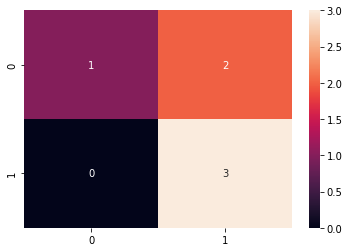

In [53]:
matrix = confusion_matrix(y_test.tolist(),previsoes)
print(matrix)
sns.heatmap(matrix,annot=True)

In [57]:
score  = cross_val_score(SGDClassifier(), df_individuo_22['imagem'].values.tolist(),df_individuo_22['classe'].values.tolist(),cv=10)
print('R²= ', np.mean(score))

R²=  0.9


### Treinamento com Todos os dados

In [26]:
df_T_individuos.head()

,imagem,classe
0,"[0.3447005794665396, 0.0, 0.08863276806094694,...",22_F
1,"[0.4807118195017684, 0.0, 0.0, 0.0, 0.45221561...",42_F
2,"[0.39869247096481547, 0.18549175045228403, 0.2...",44_V
3,"[0.3351086635795827, 0.017867648747029712, 0.1...",58_F
4,"[0.27754383539809535, 0.011966001402494146, 0....",64_V


# Tratamentos

# Data Augmentation

# Sklearn

## Imports

In [ ]:
import matplotlib.pyplot as plt
import seaborn as snb
import pandas as pd
import numpy as np
import sklearn
from mpl_toolkits.mplot3d import Axes3D
from sklearn.manifold import TSNE
from sklearn.metrics import confusion_matrix
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict

In [ ]:
np.random.seed(42)

# Explorando dados


In [ ]:
dados = pd.read_csv('/content/drive/MyDrive/Ciência de dados/IRIS.csv')
dados = dados[dados['species']!="Iris-virginica"]
dados.head()

In [ ]:
X = dados.drop(columns=['species'])
print(X)
Y = pd.factorize(dados['species'])
Y

In [ ]:
plt.figure(figsize=(15,15)).add_subplot(projection='3d')
plt.scatter(X['sepal_length'],X['sepal_width'],X['petal_length'], c=Y[0] )
plt.show()

## Dividindo dataset


In [ ]:
X_train, X_test, Y_train, Y_test = train_test_split( X.values, Y[0], test_size=0.2)

## Treinamento 

In [ ]:
def get_model():
    return LogisticRegression()

In [ ]:
model = get_model().fit(X_train,Y_train)
score = model.score(X_test,Y_test)
print(f"Acuracia: {score}")

In [ ]:
score  = cross_val_score(get_model(),X.values,Y[0], cv=10)
print(np.mean(score))

## Validação

In [ ]:
predicoes = cross_val_predict(get_model(),X.values,Y[0], cv=10)
cm = confusion_matrix(Y[0],predicoes)

In [ ]:
cm

# Regressão


In [ ]:
import matplotlib.pyplot as plt
import seaborn as snb
import pandas as pd
import numpy as np
import sklearn
from sklearn.utils import shuffle
from mpl_toolkits.mplot3d import Axes3D
from sklearn.ensemble import RandomForestRegressor
from sklearn.manifold import TSNE
from sklearn.metrics import confusion_matrix
from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict

### Importando dados

In [ ]:
df  = pd.read_csv('/content/drive/MyDrive/Ciência de dados/classificacao/dados_classificacao.csv')

In [ ]:
df  = shuffle(df)
df.reset_index(inplace= True)
df.columns = ['x','y','Class']

In [ ]:
df.head()

In [ ]:
df.dropna(inplace=True)

In [ ]:
f = pd.factorize(df['Class'])

In [ ]:
df['Class'] =  f[0]

In [ ]:
df.head()

In [ ]:
plt.figure(figsize=(10,8))
plt.scatter(df['x'].values,df['y'].values, c=df['Class'])
plt.axis('off')
plt.show()

### Preparando dados

In [ ]:
X = df.drop(columns='y')
Y = df.drop(columns=['x','Class'])

In [ ]:
X_train, X_test, Y_train, Y_test = train_test_split( X.values, Y.values, test_size=0.2)

In [ ]:
print(X_train.shape)
print(X_test.shape)

### Treinamento

In [ ]:
def getModel():

    return LinearRegression()
    # return RandomForestRegressor()

In [ ]:
model  = getModel().fit(X_train,Y_train)
score = model.score(X_test,Y_test)
print(score)

### validação de maneira mais elaborada


In [ ]:
score  = cross_val_score(getModel(), X,Y,cv=10)
print('R²= ', np.mean(score))

### Verificando Correlação

In [ ]:
y_pred = cross_val_predict(getModel(),X,Y,cv=10)

In [ ]:
plt.scatter(Y,y_pred,c= X['Class'])
plt.show()

In [ ]:
plt.scatter(X['x'],y_pred, c= X['Class'])
plt.show()